In [1]:
import glob
import numpy as np
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from scipy.spatial.distance import squareform
import matplotlib.pyplot as plt
import seaborn as sns
import os
from tqdm import tqdm
import MDAnalysis as mda
from MDAnalysis.coordinates.XTC import XTCWriter

/Users/massimodellepiane/Developer/MD_analysis/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


<h1>FUNCTIONS</h1>

In [2]:
def parse_cd_file(file_path):
    """
    Parses a .cd file to extract wavelength and intensity data.
    
    Parameters:
    file_path (str): Path to the .cd file.
    
    Returns:
    tuple: Two numpy arrays containing the wavelength and intensity data.
    """
    wavelength = []
    intensity = []
    with open(file_path, 'r') as file:
        for line in file:
            parts = line.split()
            wavelength.append(float(parts[0]))
            intensity.append(float(parts[1])/50.0)
    return np.array(wavelength), np.array(intensity)

In [3]:
def compute_nrmsd(spectrum1, spectrum2):
    """
    Computes the Normalized Root Mean Square Deviation (NRMSD) between two CD spectra.
    
    Parameters:
    spectrum1 (str): Path to the first .cd file.
    spectrum2 (str): Path to the second .cd file.
    
    Returns:
    float: The NRMSD value.
    """
    # Extract the wavelength and intensity data for both spectra
    w1, i1 = parse_cd_file(spectrum1)
    w2, i2 = parse_cd_file(spectrum2)
    
    # Interpolate spectra to have the same wavelengths if necessary
    common_wavelengths = np.intersect1d(w1, w2)
    i1_interpolated = np.interp(common_wavelengths, w1, i1)
    i2_interpolated = np.interp(common_wavelengths, w2, i2)
    
    # Calculate the NRMSD according to the formula
    w = len(common_wavelengths)
    i_exp_max = np.max(i2_interpolated)
    i_exp_min = np.min(i2_interpolated)
    intensity_diff_squared = (i1_interpolated - i2_interpolated) ** 2
    nrmsd = np.sqrt((1 / w) * (1 / (i_exp_max - i_exp_min)) * np.sum(intensity_diff_squared))
    return nrmsd

In [4]:
def compute_nrmsd_matrix(cd_files, verbose=True):
    num_files = len(cd_files)
    nrmsd_matrix = np.zeros((num_files, num_files))  # Initialize a square matrix
    total_comparisons = num_files * (num_files - 1) / 2
#    comparisons_done = 0

    # Initialize tqdm progress bar
    pbar = tqdm(total=total_comparisons, desc='Computing NRMSD', unit='cmp')

    for i in range(num_files):
        for j in range(i + 1, num_files):  # Only fill upper half of the matrix
            nrmsd_value = compute_nrmsd(cd_files[i], cd_files[j])
            nrmsd_matrix[i][j] = nrmsd_value
            nrmsd_matrix[j][i] = nrmsd_value  # Mirror the value since the matrix is symmetric

            # Update the progress bar
            pbar.update(1)

    # Close the progress bar upon completion
    pbar.close()
    
#            comparisons_done += 1
#            if verbose:
#                progress = (comparisons_done / total_comparisons) * 100
#                print(f"Progress: {progress:.2f}% ({comparisons_done} of {total_comparisons} comparisons)")

    return nrmsd_matrix

In [5]:
def load_nrmsd_matrix(load_path):
    # Load the matrix from the specified path
    return np.loadtxt(load_path, delimiter=',')

In [6]:
def visualize_nrmsd_matrix(nrmsd_matrix, labels=None):
    """
    Visualizes the NRMSD matrix as a color-coded heatmap.
    
    Parameters:
    nrmsd_matrix (np.array): A 2D NumPy array containing the NRMSD values.
    labels (list): Optional; a list of labels for the CD spectra.
    """
    # Set the context and style of the plot for better readability
    #sns.set(context='notebook', style='white')

    # Create the heatmap using Seaborn
    plt.figure(figsize=(12, 8), dpi=300, facecolor='w')
    ax = sns.heatmap(nrmsd_matrix, annot=False, fmt=".2f", cmap='viridis', 
                     linewidths=0, square=True, cbar_kws={"shrink": .5})

    # Label the axes if labels are provided
    if labels:
        ax.set_xticklabels(labels, rotation=45, ha='right')
        ax.set_yticklabels(labels, rotation=0)
    
    # Set axis labels
    ax.set_xlabel('Spectra')
    ax.set_ylabel('Spectra')
    
    # Title of the heatmap
    ax.set_title('NRMSD Heatmap')

    # Show the plot
    plt.show()

In [7]:
def visualize_clustered_nrmsd_matrix(nrmsd_matrix, Z, max_d):
    """
    Visualizes the NRMSD matrix as a color-coded heatmap, rearranged according to hierarchical clustering,
    with a dendrogram representing the clustering plotted alongside the heatmap without axis labels.

    Parameters:
    nrmsd_matrix (np.array): A 2D NumPy array containing the NRMSD values.
    Z (np.array): Linkage matrix from hierarchical clustering.
    max_d (float): Threshold distance to define clusters.
    """

    # Determine the number of observations
    n = nrmsd_matrix.shape[0]

    # Create a figure to contain both the dendrogram and the heatmap
    fig = plt.figure(figsize=(12, 8), dpi=300, facecolor='w')

    # Create dendrogram axes
    ax_dendro = fig.add_axes([0.05, 0.1, 0.225, 0.6], frame_on=False)
    dendrogram_result = dendrogram(Z, orientation='left', color_threshold=max_d, above_threshold_color='k', no_labels=True, ax=ax_dendro)
    ax_dendro.set_xticks([])
    ax_dendro.set_yticks([])

    # Turn off the axis
    ax_dendro.axis('off')

    # Identify the order of the rows according to the dendrogram
    Z_idx = dendrogram_result['leaves']

    # Reorder the NRMSD matrix according to the clustering
    nrmsd_matrix_ordered = nrmsd_matrix[Z_idx, :][:, Z_idx]

    # Create heatmap axes
    ax_heatmap = fig.add_axes([0.2, 0.1, 0.6, 0.6])
    sns.heatmap(nrmsd_matrix_ordered, annot=False, cmap='viridis', linewidths=0, square=True, cbar_kws={"shrink": .5}, ax=ax_heatmap)

    # Turn off the axis labels
    ax_heatmap.set_xticks([])
    ax_heatmap.set_yticks([])

    # Set title
    plt.title('Clustered NRMSD Heatmap', loc='center')

    # Show the plot
    plt.show()




In [8]:
def get_highest_nrmsd_files(nrmsd_matrix, all_cd_files, N):
    # Make a copy of the NRMSD matrix to avoid changing the original
    nrmsd_copy = np.copy(nrmsd_matrix)
    # Set the diagonal to negative infinity to ignore it
    np.fill_diagonal(nrmsd_copy, -np.inf)

    # Flatten the matrix and sort it to find the indices of the N highest values
    flat_indices = np.argsort(-nrmsd_copy, axis=None)[:N]

    # Convert flat indices to 2D indices
    row_indices, col_indices = np.unravel_index(flat_indices, nrmsd_matrix.shape)

    # Get the file names for each pair
    highest_pairs_files = [(all_cd_files[row], all_cd_files[col]) for row, col in zip(row_indices, col_indices) if row != col]

    return highest_pairs_files

In [9]:
def get_highest_nrmsd_values(nrmsd_matrix, N):
    # Make a copy of the NRMSD matrix to avoid changing the original
    nrmsd_copy = np.copy(nrmsd_matrix)
    # Set the diagonal to negative infinity to ignore it
    np.fill_diagonal(nrmsd_copy, -np.inf)

    # Flatten the matrix and sort it to find the indices of the N highest values
    flat_indices = np.argsort(-nrmsd_copy, axis=None)[:N]

    # Convert flat indices to 2D indices
    row_indices, col_indices = np.unravel_index(flat_indices, nrmsd_matrix.shape)

    # Get the NRMSD values for each pair, excluding the diagonal
    highest_values = [nrmsd_matrix[row, col] for row, col in zip(row_indices, col_indices) if row != col]

    return highest_values

In [10]:
def get_lowest_nonzero_nrmsd_files(nrmsd_matrix, all_cd_files, N):
    # Copy the matrix to avoid changing the original and mask zeros
    nrmsd_copy = np.copy(nrmsd_matrix)
    nrmsd_copy[nrmsd_copy == 0] = np.inf  # Replace zeros with infinity
    np.fill_diagonal(nrmsd_copy, np.inf)  # Ignore the diagonal (self-comparisons)

    # Find the indices of the N lowest non-zero values
    flat_indices = np.argsort(nrmsd_copy, axis=None)[:N]
    row_indices, col_indices = np.unravel_index(flat_indices, nrmsd_matrix.shape)

    # Get the file names for each pair
    lowest_pairs_files = [(all_cd_files[row], all_cd_files[col]) for row, col in zip(row_indices, col_indices) if row != col]

    return lowest_pairs_files


In [11]:
def get_lowest_nonzero_nrmsd_values(nrmsd_matrix, N):
    # Copy the matrix to avoid changing the original and mask zeros
    nrmsd_copy = np.copy(nrmsd_matrix)
    nrmsd_copy[nrmsd_copy == 0] = np.inf  # Replace zeros with infinity
    np.fill_diagonal(nrmsd_copy, np.inf)  # Ignore the diagonal (self-comparisons)

    # Find the indices of the N lowest non-zero values
    flat_indices = np.argsort(nrmsd_copy, axis=None)[:N]
    row_indices, col_indices = np.unravel_index(flat_indices, nrmsd_matrix.shape)

    # Get the NRMSD values for each pair
    lowest_values = [nrmsd_matrix[row, col] for row, col in zip(row_indices, col_indices) if row != col]

    return lowest_values


In [12]:
def plot_cd_spectra(file1, file2, save_path=None):
    # Parse the .cd files to get wavelength and intensity
    w1, i1 = parse_cd_file(file1)
    w2, i2 = parse_cd_file(file2)
    
    # Extract the base file name for the legend
    base_name1 = os.path.basename(file1)
    base_name2 = os.path.basename(file2)
    
    # Create a square figure
    fig = plt.figure(figsize=(9, 9), dpi=300, facecolor='w')
    plt.subplots_adjust(left=0.15, bottom=0.15, right=0.85, top=0.85, wspace=None, hspace=0.05)
    
    # Plot the spectra with thicker lines
    plt.plot(w1, i1, label=base_name1, linewidth=3)
    plt.plot(w2, i2, label=base_name2, linewidth=3)
    
    # Set the x and y axis labels with bold font
    plt.xlim([180,320])
    plt.xlabel(r'wavelength $\lambda$ /(nm)', fontsize=30)
    plt.ylabel(r'$\theta_{MRE}$ $10^3$ (deg cm$^2$ dmol$^{-1}$)', fontsize=30)

     # Set the tick parameters
    plt.tick_params(axis='both', which='major', labelsize='large')
    
    # Enhance the legend with bold font
    plt.legend(fontsize='large', frameon=True, edgecolor='black')
    
    # If a save path is provided, save the figure with 300 DPI
    if save_path:
        plt.savefig(save_path, dpi=300)
    
    # Show the plot on the screen
    plt.show()

In [13]:
def plot_cluster_spectra(clusters, all_cd_files):
    """
    Plots all spectra and their average for each cluster, and then plots the average of all clusters in a single figure.
    
    Parameters:
    clusters (array): An array with cluster labels for each spectrum.
    all_cd_files (list): List of file paths for the spectra.
    """
    color_sequence = ['orange', 'limegreen', 'r', 'mediumpurple', 'sienna', 'pink']
    
    # Extend the color sequence with 'black' for any clusters beyond those specified
    # Assuming clusters are 1-indexed (starting from 1), adjust if different
    color_mapping = {i+1: color_sequence[i] if i < len(color_sequence) else 'black' for i in range(len(set(clusters)))}

    # Create a dictionary to hold file paths for each cluster
    cluster_files = {i: [] for i in set(clusters)}
    cluster_averages = {}

    # Assign files to the corresponding cluster
    for file, cluster in zip(all_cd_files, clusters):
        cluster_files[cluster].append(file)

    # Process each cluster
    for cluster, files in cluster_files.items():
        fig = plt.figure(figsize=(4, 4), dpi=300, facecolor='w')
        plt.subplots_adjust(left=0.15, bottom=0.15, right=0.85, top=0.85, wspace=None, hspace=0.05)
        all_spectra = []

        # Determine the color for the current cluster using the mapping
        color = color_mapping.get(cluster, 'black')

        # Read and plot each file in the cluster
        for file in files:
            wavelength, intensity = parse_cd_file(file)
            plt.plot(wavelength, intensity, color='black', linewidth=0.2, alpha=0.3)
            all_spectra.append(intensity)

        # Calculate and plot the average spectrum
        average_spectrum = np.mean(all_spectra, axis=0)
        STD = np.std(all_spectra, axis=0)
        cluster_averages[cluster] = (wavelength, average_spectrum)
        plt.plot(wavelength, average_spectrum, color=color, linewidth=3, label='Average')
        plt.fill_between(wavelength, average_spectrum - STD, average_spectrum + STD, color=color, alpha=0.3)

        # Customizing the plot
        plt.title(f'Cluster {cluster} Spectra')
        plt.xlim([180,320])
        plt.xlabel(r'wavelength $\lambda$ /(nm)')
        plt.ylabel(r'$\theta_{MRE}$ $10^3$ [deg cm$^2$ dmol$^{-1}$]')
        plt.legend()
        plt.show()

    # Plotting the average spectra of all clusters in a single figure
    fig = plt.figure(figsize=(9, 9), dpi=300, facecolor='w')
    plt.subplots_adjust(left=0.15, bottom=0.15, right=0.85, top=0.85, wspace=None, hspace=0.05)
    
    for cluster, (wavelength, avg_spectrum) in cluster_averages.items():
        # Use the color mapping for the cluster
        color = color_mapping.get(cluster, 'black')
        plt.plot(wavelength, avg_spectrum, color=color, linewidth=4, label=f'Cluster {cluster}')

    plt.xlabel(r'wave length $\lambda$ (nm)', fontsize=30)
    plt.ylabel(r'$\theta_{MRE}$ $10^3$ (deg cm$^2$ dmol$^{-1}$)', fontsize=30)
    plt.ylim([-70,70])
    plt.xlim([180,320])

    ax1 = plt.gca()
    for tick in ax1.xaxis.get_major_ticks():
        tick.label1.set_fontsize(25)
    for tick in ax1.yaxis.get_major_ticks():
        tick.label1.set_fontsize(25)

    #plt.legend()
    plt.show()





In [14]:
def plot_cluster_spectra_single(clusters, all_cd_files, cluster_id, color):
    """
    Plots all spectra and their average for one cluster, 
    """
    # Create a dictionary to hold file paths for each cluster
    cluster_files = {i: [] for i in set(clusters)}
    cluster_averages = {}

    # Assign files to the corresponding cluster
    for file, cluster in zip(all_cd_files, clusters):
        cluster_files[cluster].append(file)

    # Process each cluster
    for cluster, files in cluster_files.items():
        if cluster == cluster_id:
            # Create a square figure
            fig = plt.figure(figsize=(9, 9), dpi=300, facecolor='w')
            plt.subplots_adjust(left=0.15, bottom=0.15, right=0.85, top=0.85, wspace=None, hspace=0.05)
            all_spectra = []

            # Read and plot each file in the cluster
            for file in files:
                wavelength, intensity = parse_cd_file(file)
                plt.plot(wavelength, intensity, color='black', linewidth=0.2, alpha=0.3)
                all_spectra.append(intensity)

            # Calculate and plot the average spectrum
            average_spectrum = np.mean(all_spectra, axis=0)
            STD = np.std(all_spectra, axis=0)
            cluster_averages[cluster] = (wavelength, average_spectrum)
            plt.plot(wavelength, average_spectrum, color=color, linewidth=3, label='Average')
            plt.fill_between(wavelength, average_spectrum - STD, average_spectrum + STD, color=color, alpha=0.3)

            # Customizing the plot
            plt.xlabel(r'wave length $\lambda$ (nm)', fontsize=30)
            plt.ylabel(r'$\theta_{MRE}$ $10^3$ (deg cm$^2$ dmol$^{-1}$)', fontsize=30)
            plt.ylim([-70,70])
            plt.xlim([180,320])

            ax1 = plt.gca()
            for tick in ax1.xaxis.get_major_ticks():
                tick.label1.set_fontsize(25)
            for tick in ax1.yaxis.get_major_ticks():
                tick.label1.set_fontsize(25)
            #plt.title(f'Cluster {cluster} Spectra')
            #plt.xlim([180,320])
            #plt.xlabel(r'wavelength $\lambda$ [nm]', fontsize='large')
            #plt.ylabel(r'$\theta_{MRE}$ $10^3$ [deg cm$^2$ dmol$^{-1}$]', fontsize='large')
            #plt.legend()
            plt.show()



In [15]:
def get_cd_files_by_cluster(clusters, all_cd_files):
    cluster_files = {i: [] for i in set(clusters)}

    for file, cluster in zip(all_cd_files, clusters):
        cluster_files[cluster].append(file)

    return cluster_files

In [16]:
def get_times_for_cd_files(cd_files, timestep, cd_save_frequency):
    """
    Calculates the corresponding times in picoseconds for a list of CD files based 
    on the simulation timestep and the frequency at which CD files are saved.
    """
    times_in_ps = []
    for file_path in cd_files:
    # Extract the filename from the file path
        filename = file_path.split('/')[-1]

     # Extract the spectrum index from the file name
        spectrum_index = int(filename.split('-')[-1].split('.')[0])

        # Compute the time in picoseconds
        time_ps = spectrum_index * timestep * cd_save_frequency
        times_in_ps.append(time_ps)

    return times_in_ps

In [17]:
def extract_and_save_cluster_frames(trajectory_path, topology_path, cd_files_by_cluster, timestep, cd_save_frequency, save_path):
    # Load the trajectory and topology
    universe = mda.Universe(topology_path, trajectory_path)

    for cluster_label, cd_files in cd_files_by_cluster.items():
        # Get times for CD files
        cluster_times = get_times_for_cd_files(cd_files, timestep, cd_save_frequency)

        # Calculate the frame indices
        frame_indices = [int(time / timestep) for time in cluster_times]

        # Set up the XTC writer for each cluster
        output_filename = os.path.join(save_path, f"cd_cluster_sorted_{cluster_label}.xtc")
        with XTCWriter(output_filename, n_atoms=universe.atoms.n_atoms) as writer:
            for frame_index in frame_indices:
                # Set the trajectory to the specific frame
                universe.trajectory[frame_index]
                # Write the frame to the new XTC file
                writer.write(universe)

<h1>MAIN</h1>

<h3>LOAD CD FILES HERE</h3>

In [18]:
import glob

# Sorted import of all .cd files (lexicographical = numerical due to leading zeros)
all_cd_files = sorted(glob.glob("/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/00_dense_CD/*.cd"))


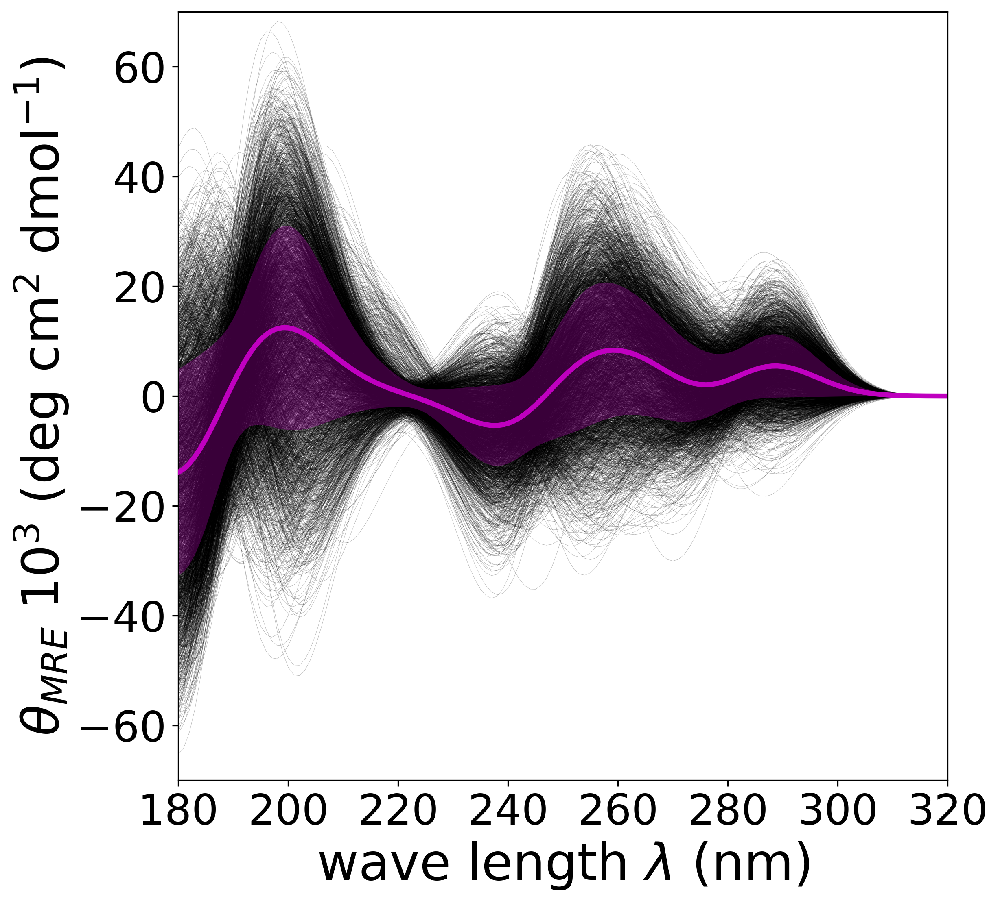

In [19]:
fig = plt.figure(figsize=(9, 9), dpi=300, facecolor='w')
plt.subplots_adjust(left=0.15, bottom=0.15, right=0.85, top=0.85, wspace=None, hspace=0.05)

average = []

for ii in all_cd_files:
    col = np.loadtxt(ii, unpack=True, usecols=[0,1])
    average.append(col[1]/50.0)
    plt.plot(col[0], col[1]/50.0, 'k-', markersize=2 ,markeredgewidth=0 ,markeredgecolor='k' ,markerfacecolor='k' ,linewidth=0.2 ,alpha=0.3, zorder=1, label="all")

average_np = np.array(average)
mean_average = np.mean(average_np, axis=0)
mean_average_rep0 = np.mean(average_np, axis=0)
STD = np.std(average_np, axis=0)
STD_NEG = STD*(-1)

plt.plot(col[0], mean_average, 'm-', markersize=0, markeredgewidth=0, markeredgecolor='m', markerfacecolor='m', linewidth=3, alpha=1, zorder=5, label="average")
#pl.errorbar(col[0], mean_average, STD, ecolor='r', zorder=4, capthick=2, linewidth=1, label="std")
plt.fill_between(col[0], mean_average - STD, mean_average + STD, facecolor='m', alpha=0.3)

plt.xlabel(r'wave length $\lambda$ (nm)', fontsize=30)
plt.ylabel(r'$\theta_{MRE}$ $10^3$ (deg cm$^2$ dmol$^{-1}$)', fontsize=30)
plt.ylim([-70,70])
plt.xlim([180,320])

ax1 = plt.gca()
for tick in ax1.xaxis.get_major_ticks():
    tick.label1.set_fontsize(25)
for tick in ax1.yaxis.get_major_ticks():
    tick.label1.set_fontsize(25)
    
# Show the plot
plt.show()

<h3>COMPUTE A MATRIX HERE...</h3>

In [21]:
# Compute the NRMSD matrix
nrmsd_matrix = compute_nrmsd_matrix(all_cd_files)

Computing NRMSD: 100%|██████████| 6626620/6626620.0 [16:44<00:00, 6594.03cmp/s]


In [20]:
# Make sure to replace 'path_to_save_matrix.csv' with the actual path where you want to save the NRMSD matrix
np.savetxt('/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/00_dense_CD/nmrds_matrix.csv', nrmsd_matrix, delimiter=',')

NameError: name 'nrmsd_matrix' is not defined

<h3>...OR LOAD A MATRIX HERE</h3>

In [20]:
# Or load a matrix
nrmsd_matrix = load_nrmsd_matrix('/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/00_dense_CD/nmrds_matrix.csv')

<h3>ANALYSIS</h3>

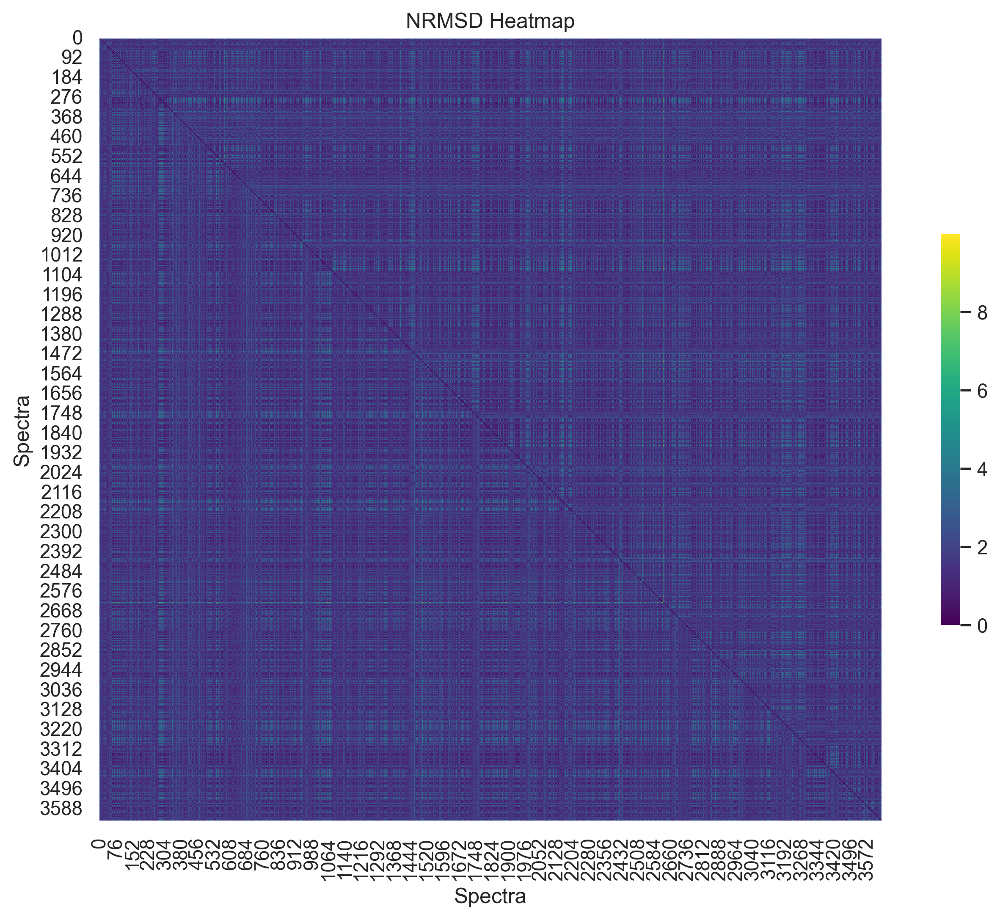

In [22]:
visualize_nrmsd_matrix(nrmsd_matrix)

In [21]:
# Assuming nrmsd_matrix is your full square NRMSD matrix
condensed_matrix = squareform(nrmsd_matrix)

<h4>CLUSTERING (Ward)</h4>

In [22]:
# Using Ward's method for clustering
Z = linkage(condensed_matrix, method='ward')

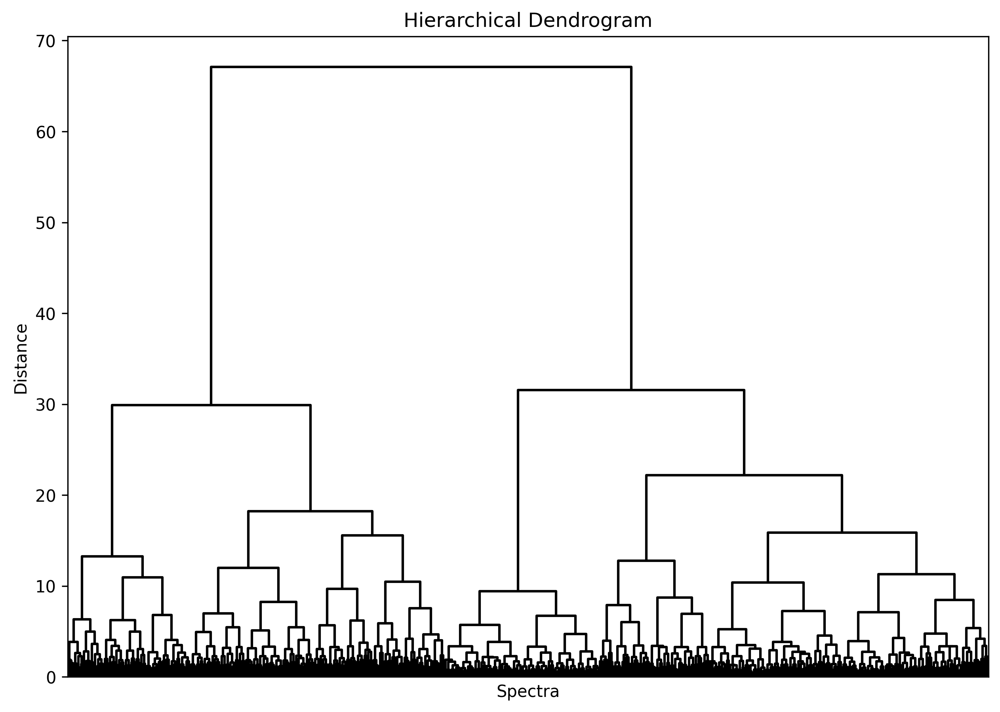

In [23]:
plt.figure(figsize=(10, 7), dpi=300, facecolor='w')
plt.title('Hierarchical Dendrogram')
plt.xlabel('Spectra')
plt.ylabel('Distance')

dendrogram(
    Z,
    color_threshold=0,  # Ensures a single color for all branches
    leaf_rotation=90.,  # rotates the x axis labels
    leaf_font_size=8.,  # font size for the x axis labels
    no_labels=True,  # Hide the leaf labels
    above_threshold_color='k',  # Set the color above the threshold to black
)

plt.show()


In [24]:
max_d = 18  # Adjust this threshold to get the desired number of clusters
clusters = fcluster(Z, max_d, criterion='distance')

# Assuming 'clusters' contains the cluster labels for each spectrum
unique_clusters, counts = np.unique(clusters, return_counts=True)

# Print the number of clusters
num_clusters = len(unique_clusters)
print(f"Number of clusters formed: {num_clusters}")

# Optionally, print the number of spectra in each cluster
for cluster, count in zip(unique_clusters, counts):
    print(f"Cluster {cluster} contains {count} spectra")


Number of clusters formed: 6
Cluster 1 contains 485 spectra
Cluster 2 contains 490 spectra
Cluster 3 contains 515 spectra
Cluster 4 contains 612 spectra
Cluster 5 contains 437 spectra
Cluster 6 contains 1102 spectra


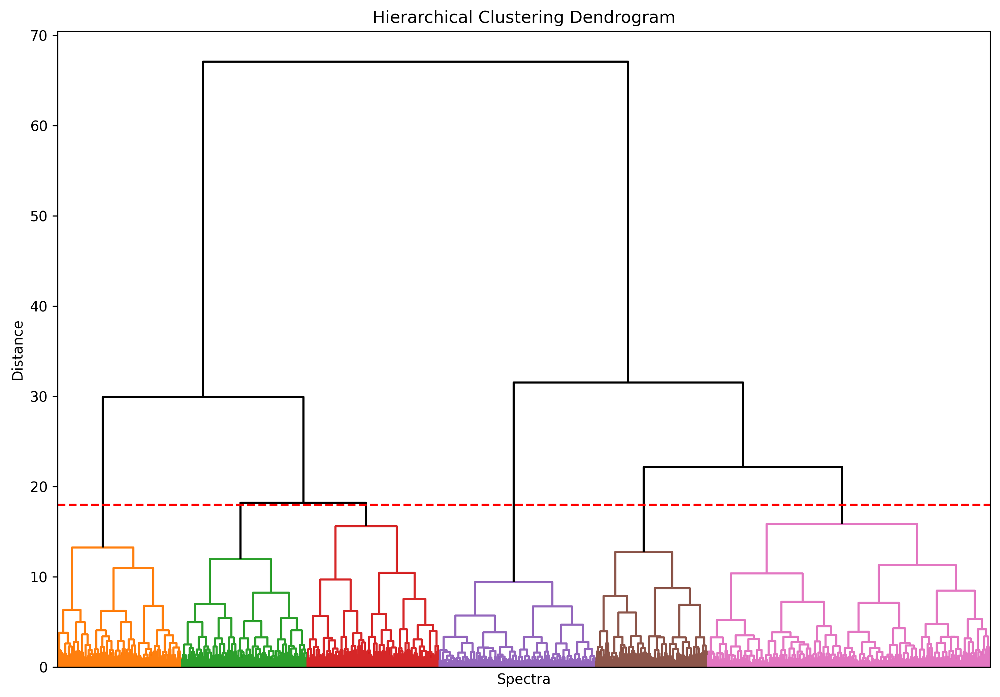

In [25]:
plt.figure(figsize=(10, 7), dpi=300, facecolor='w')
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Spectra')
plt.ylabel('Distance')

dendrogram_result = dendrogram(
    Z,
    color_threshold=max_d,
    leaf_rotation=90.,
    leaf_font_size=8.,
    no_labels=True,  # Hide the leaf labels
    above_threshold_color='k',  # Set the color above the threshold to black
)

# Draw a horizontal line at the cut-off distance
plt.axhline(y=max_d, color='r', linestyle='--')

plt.tight_layout()
plt.show()


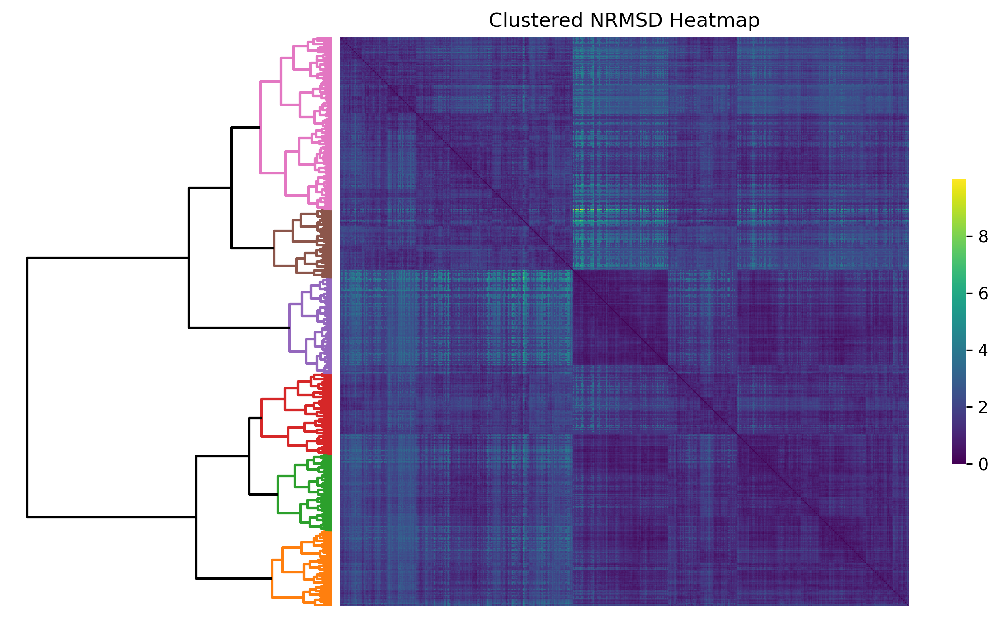

In [26]:
visualize_clustered_nrmsd_matrix(nrmsd_matrix, Z, max_d)

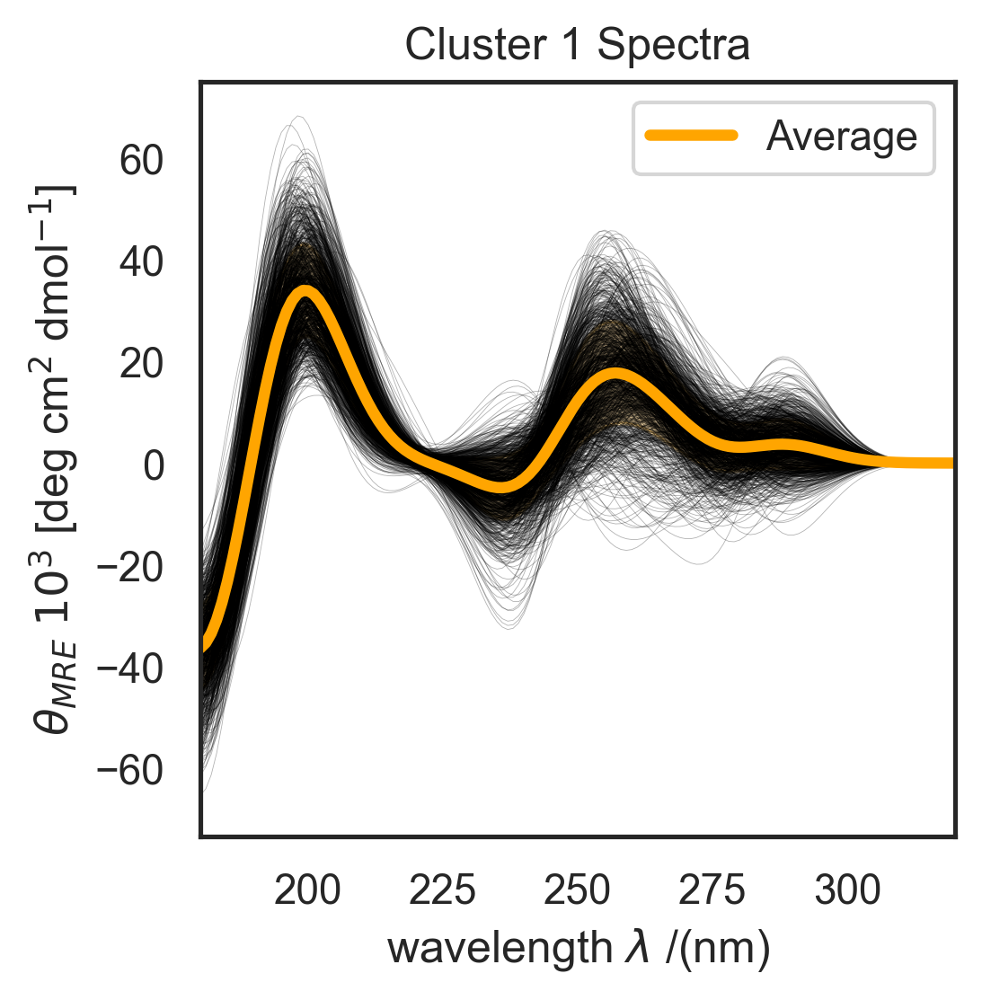

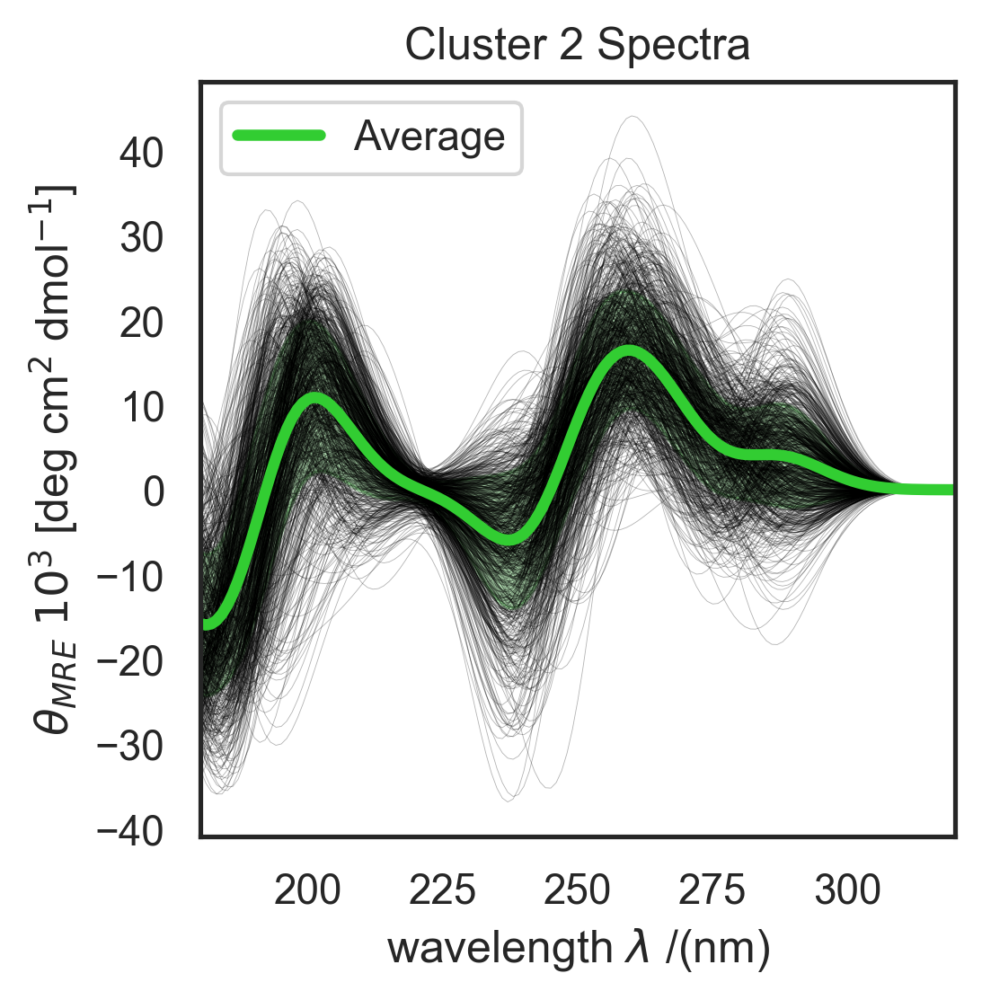

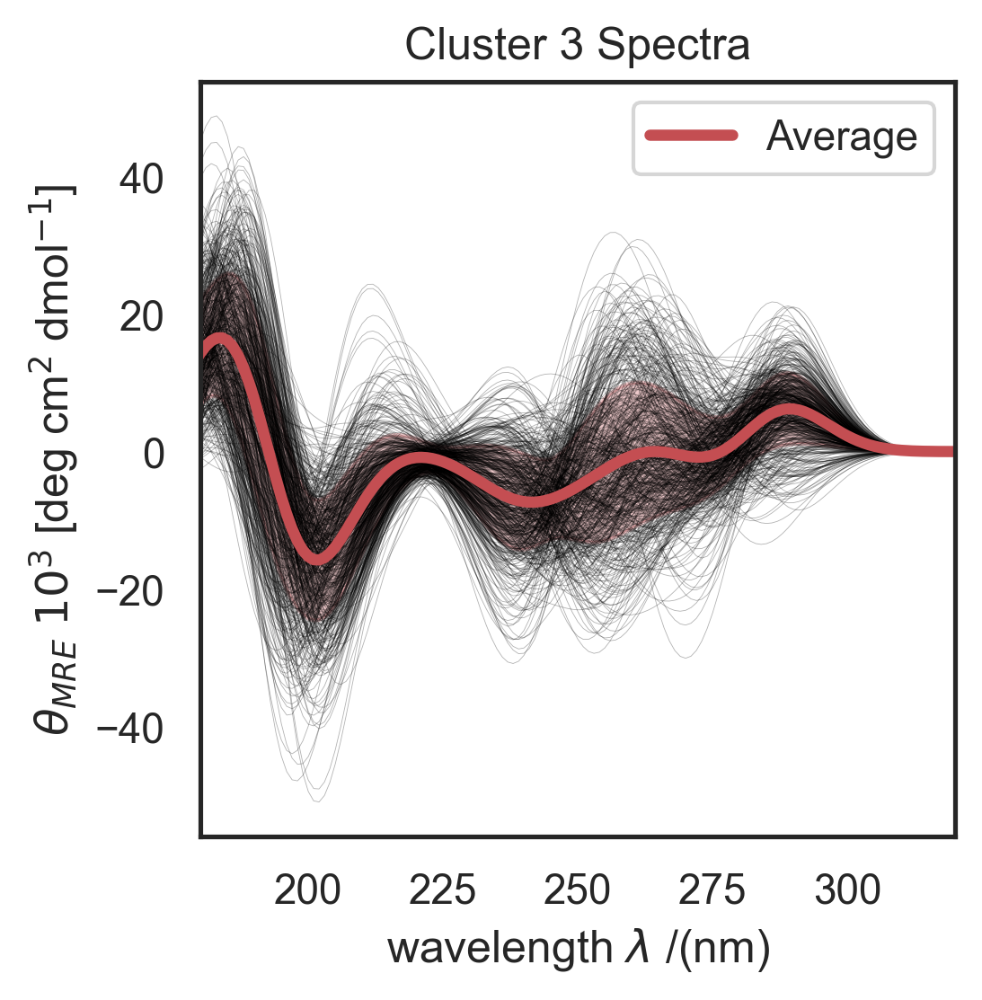

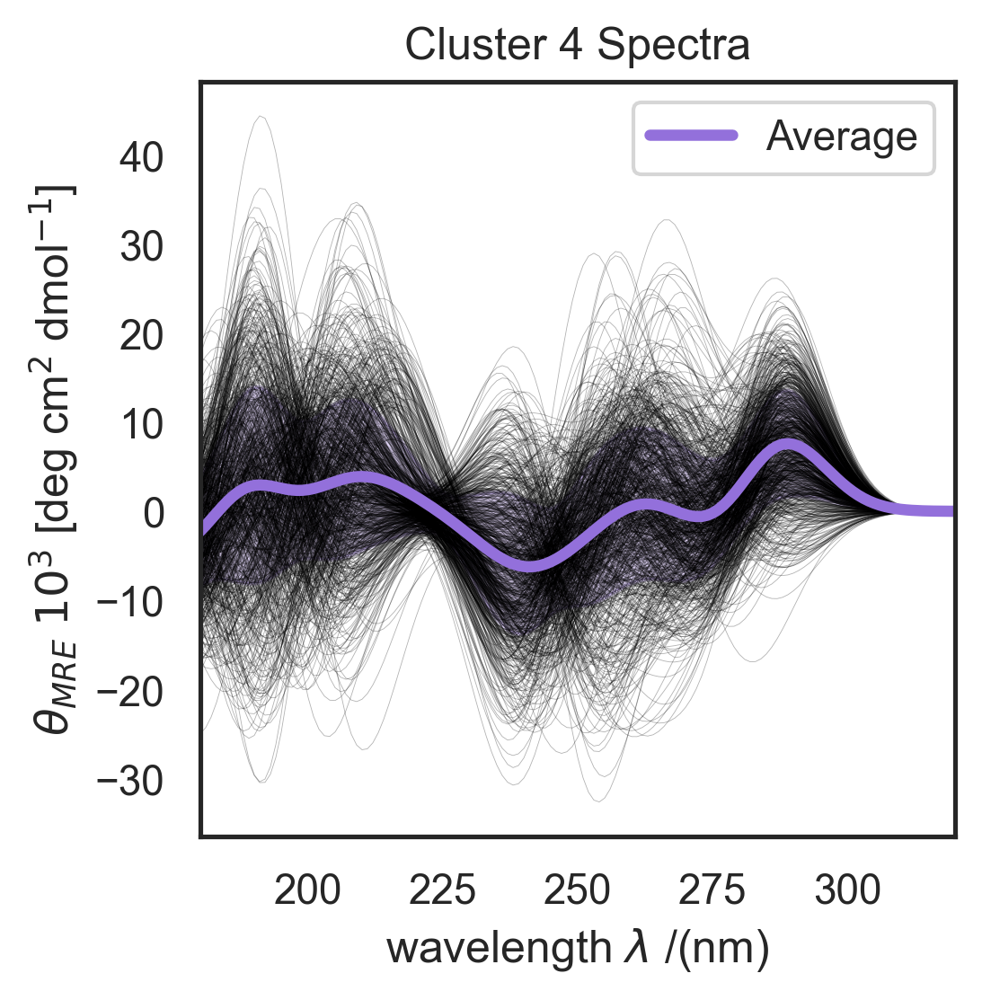

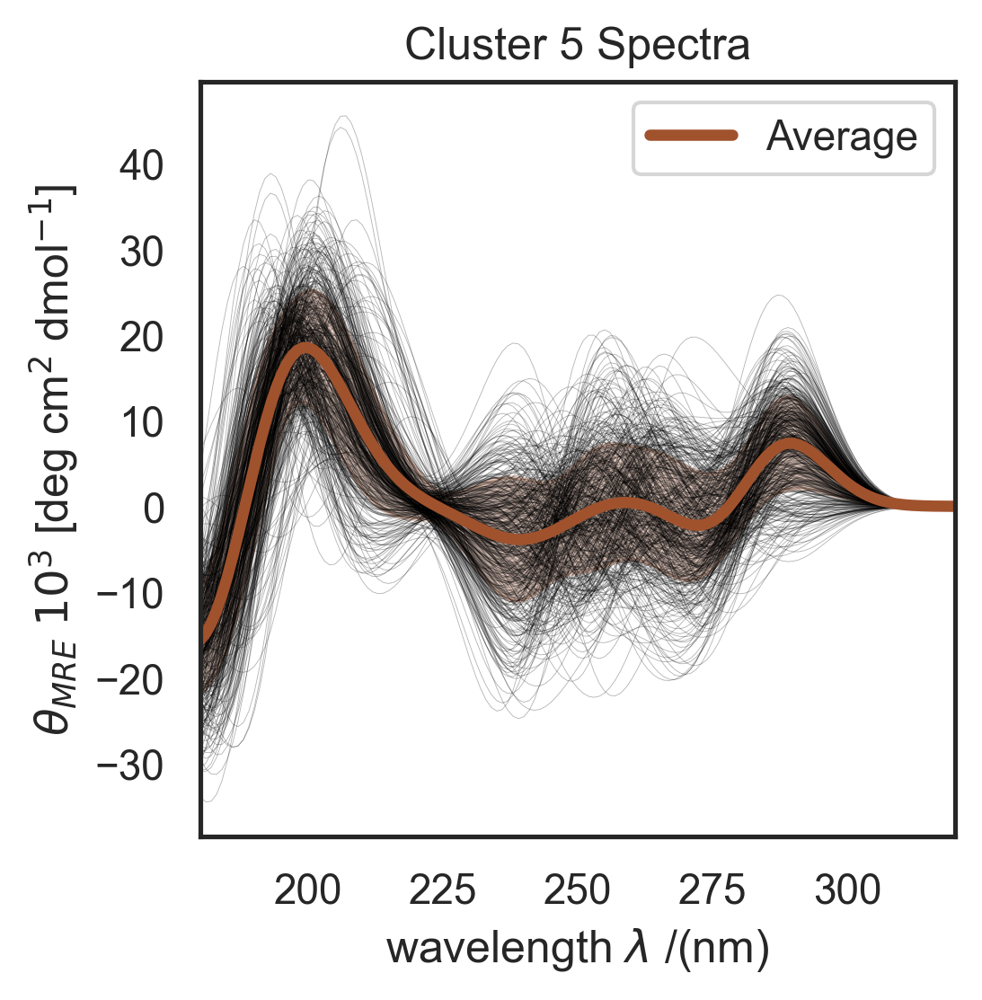

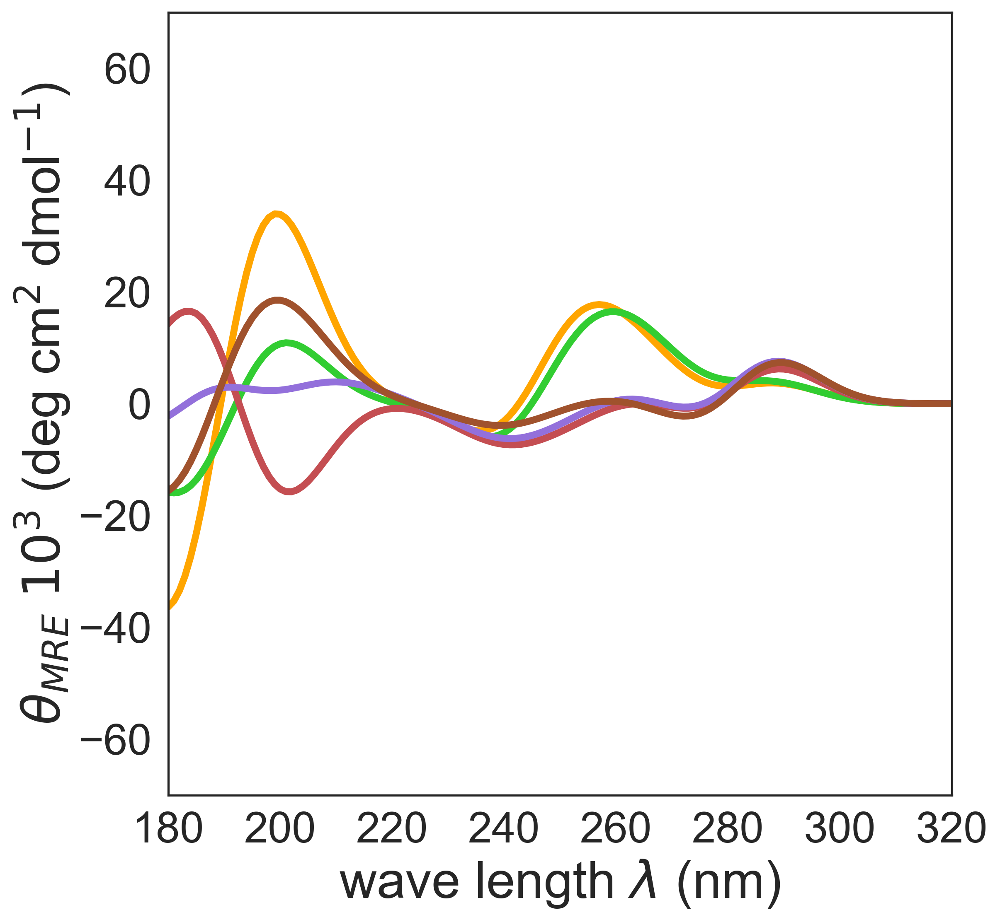

In [56]:
plot_cluster_spectra(clusters, all_cd_files)

In [57]:
def save_cluster_averages(clusters, all_cd_files, output_directory):
    """
    Saves the average spectra for each cluster in `.cd` files.

    Parameters:
    clusters (array): An array with cluster labels for each spectrum.
    all_cd_files (list): List of file paths for the spectra.
    output_directory (str): Directory to save the cluster average `.cd` files.
    """
    # Ensure the output directory exists
    os.makedirs(output_directory, exist_ok=True)

    # Create a dictionary to hold file paths for each cluster
    cluster_files = {i: [] for i in set(clusters)}
    cluster_averages = {}

    # Assign files to the corresponding cluster
    for file, cluster in zip(all_cd_files, clusters):
        cluster_files[cluster].append(file)

    # Process each cluster to calculate averages
    for cluster, files in cluster_files.items():
        all_spectra = []

        # Read and collect spectra data for the cluster
        for file in files:
            wavelength, intensity = parse_cd_file(file)
            all_spectra.append(intensity)

        # Calculate the average spectrum
        average_spectrum = np.mean(all_spectra, axis=0)
        cluster_averages[cluster] = (wavelength, average_spectrum)

        # Save the average spectrum in a .cd file
        output_path = os.path.join(output_directory, f'cluster_{cluster}_sorted_average.cd')
        with open(output_path, 'w') as f:
            for w, avg in zip(wavelength, average_spectrum):
                f.write(f"{w:15.6f}{avg:15.6f}\n")

    print(f"Cluster average spectra saved to {output_directory}")

save_cluster_averages(clusters, all_cd_files, '/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense')

Cluster average spectra saved to /Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense


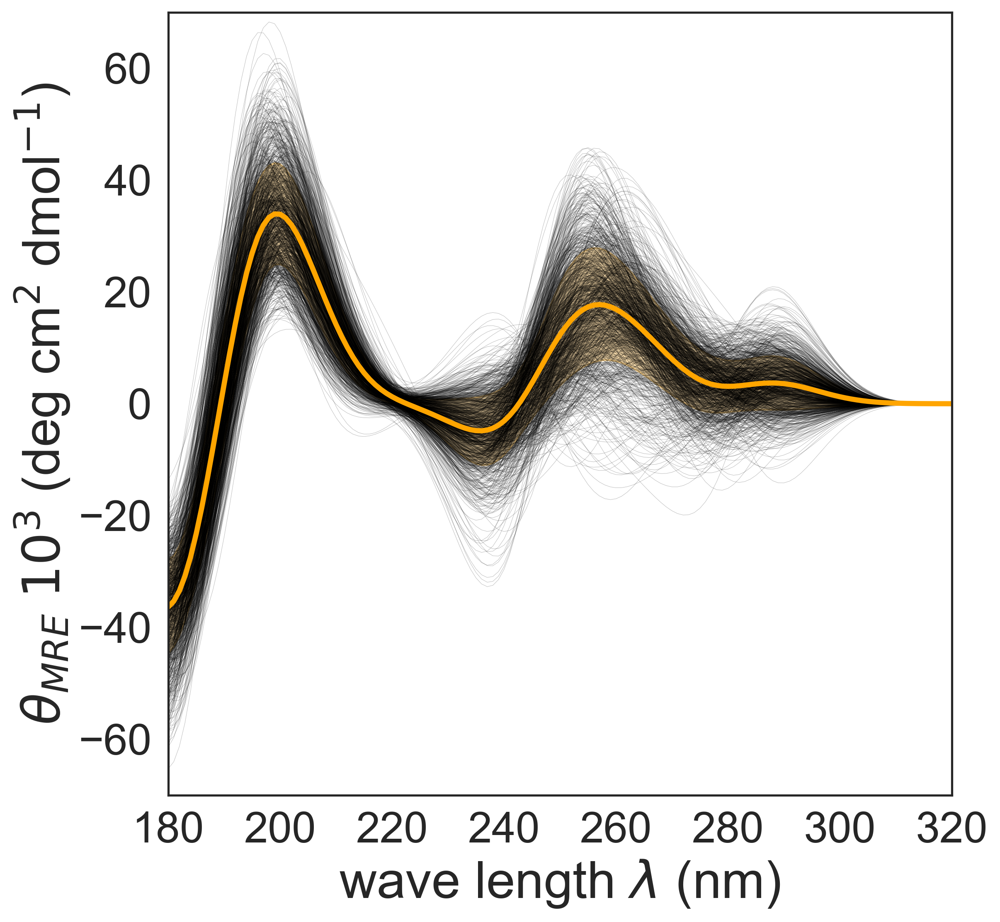

In [58]:
plot_cluster_spectra_single(clusters, all_cd_files, 1, "orange")

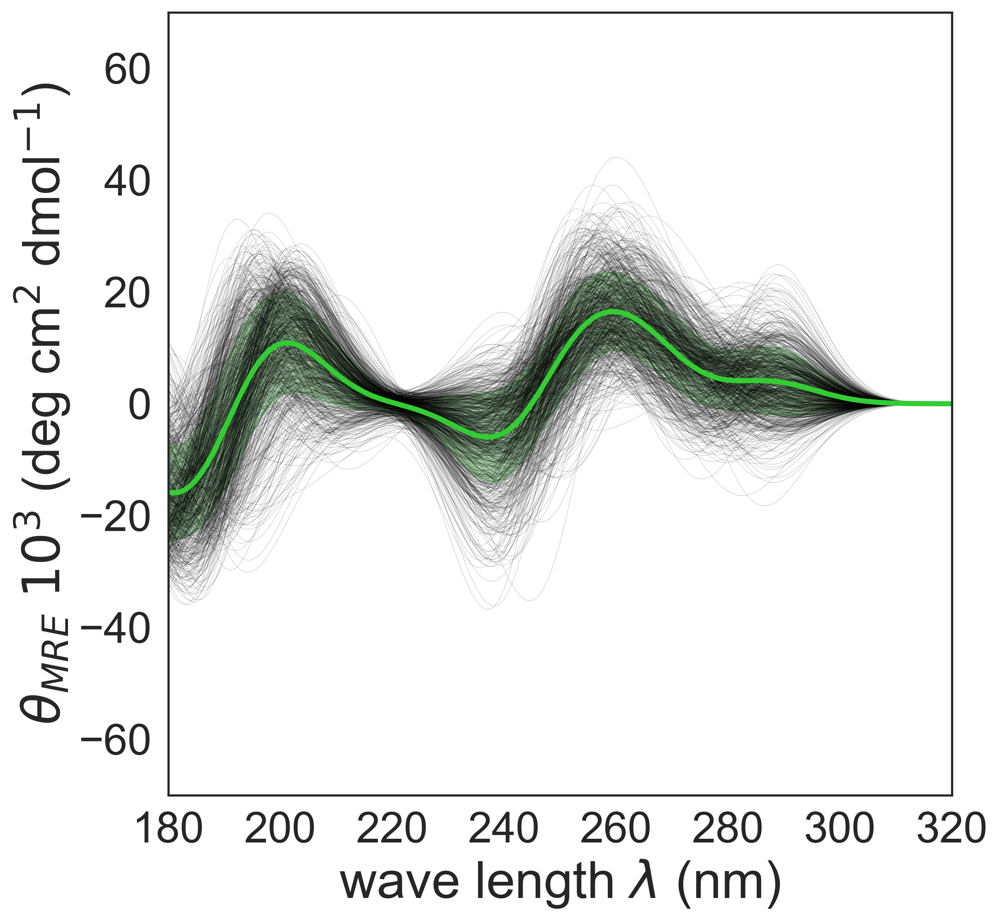

In [59]:
plot_cluster_spectra_single(clusters, all_cd_files, 2, "limegreen")

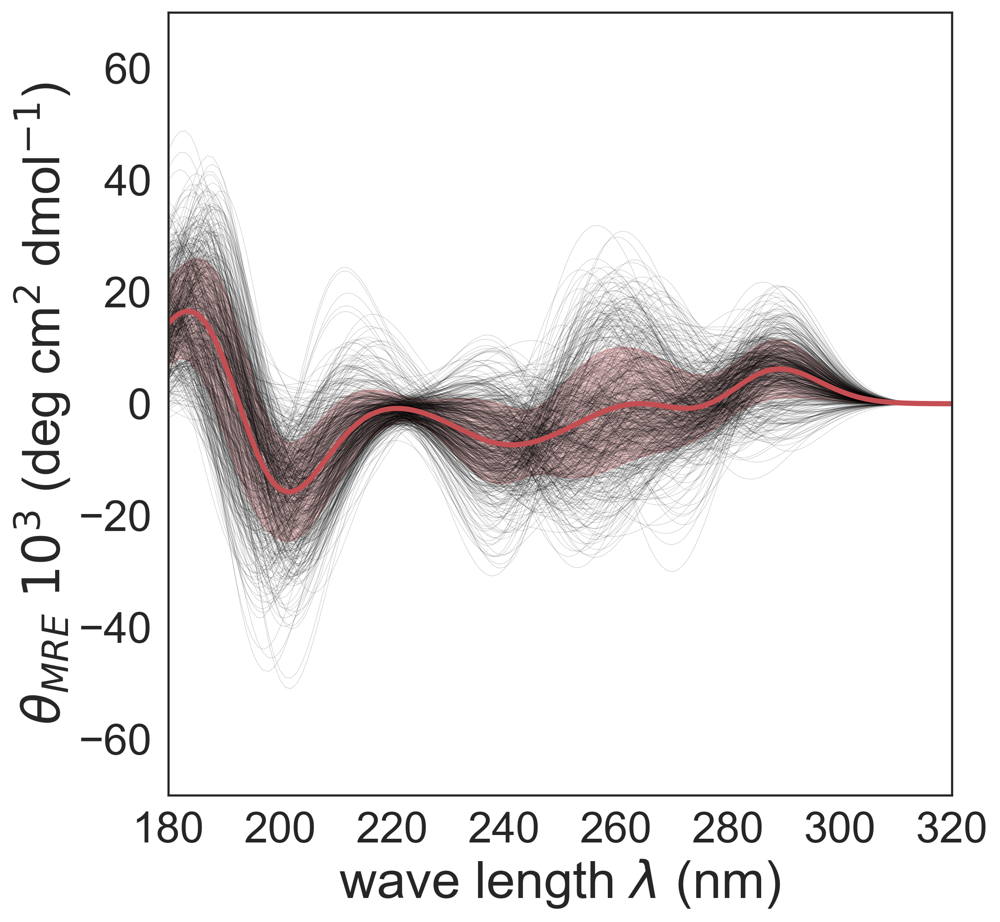

In [60]:
plot_cluster_spectra_single(clusters, all_cd_files, 3, "r")

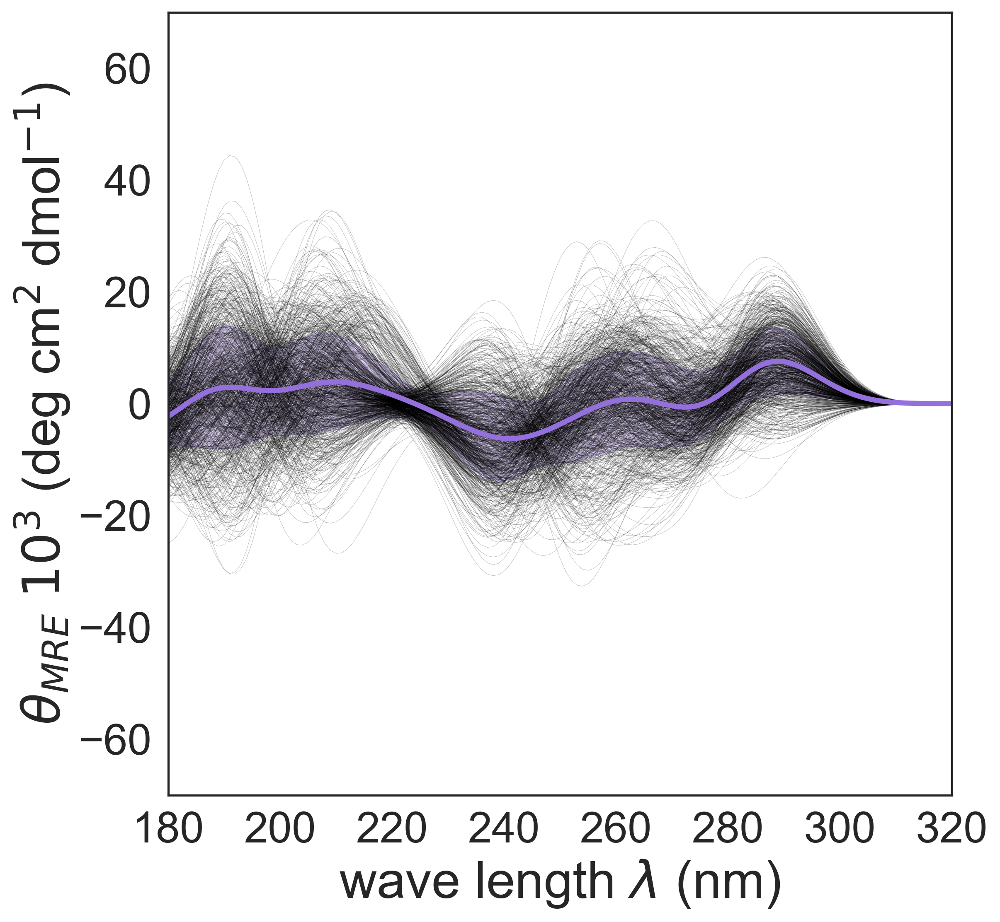

In [61]:
plot_cluster_spectra_single(clusters, all_cd_files, 4, "mediumpurple")

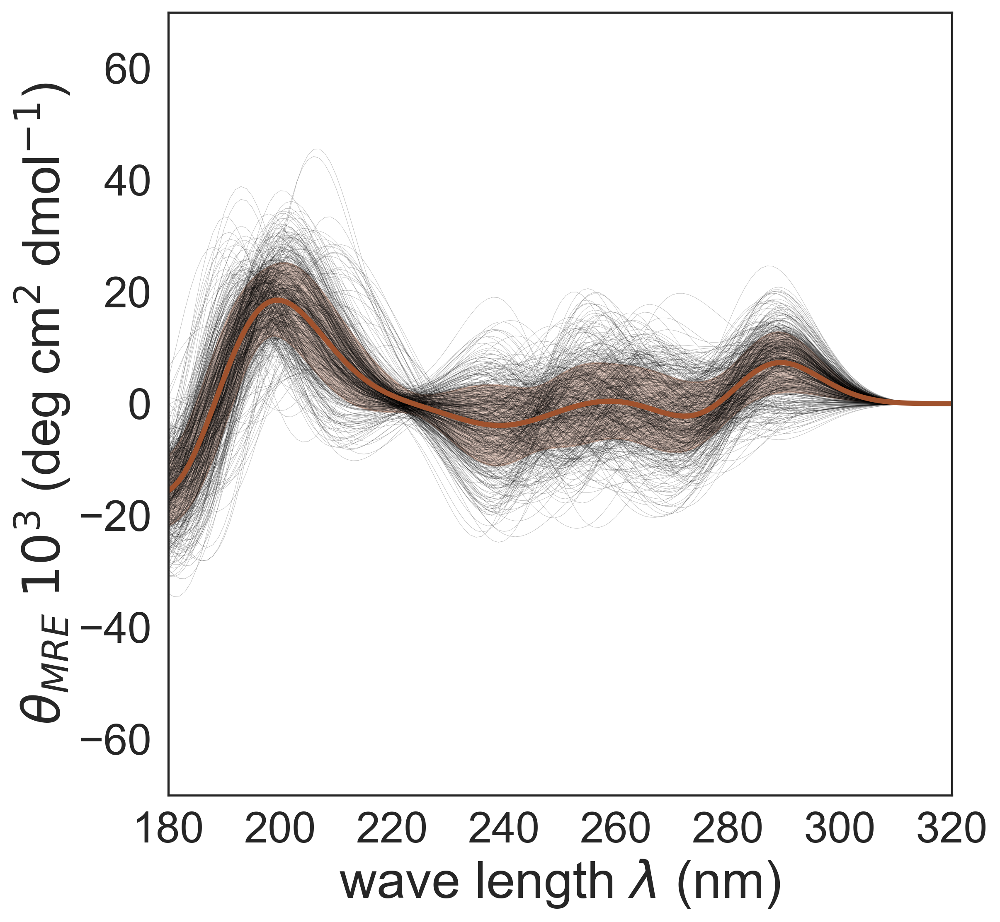

In [62]:
plot_cluster_spectra_single(clusters, all_cd_files, 5, "sienna")

In [44]:
plot_cluster_spectra_single(clusters, all_cd_files, 6, "pink")

<h4>EXPORT TRAJECTORIES</h4>

In [63]:
cd_files_by_cluster = get_cd_files_by_cluster(clusters, all_cd_files)

save_path = "/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense"

extract_and_save_cluster_frames('/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/traj-centered-whole_00.xtc', '/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/tpr.tpr', cd_files_by_cluster, 20, 5, save_path)

<h4>ANGLE ANALYSIS</h4>

In [ ]:
# List of file paths
file_paths = [
    '/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/angles_data_eta_theta_cl1',
    '/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/angles_data_eta_theta_cl2',
    '/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/angles_data_eta_theta_cl3',
    '/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/angles_data_eta_theta_cl4',
    '/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/angles_data_eta_theta_cl5',
    '/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/angles_data_eta_theta_cl6',
    # Add more file paths as needed
]

In [ ]:
# Function to process and plot data from a file
def process_and_plot_file(file_path):
    # Read the file content, skipping the first line which is the header
    with open(file_path, 'r') as file:
        lines = file.readlines()[1:]  # Skip the header line

    # Initialize lists to hold the parsed eta and theta angles for all structures
    all_eta_radians = []
    all_theta_radians = []

    # Process each line of data
    for line in lines:
        # Split the line into individual string values, excluding the last fixed value 1.000000
        values = line.strip().split()[:-1]
        
        # Convert string values to floats
        # The first 21 values are eta angles, the next 21 are theta angles
        eta_radians = [float(val) for val in values[:21]]
        theta_radians = [float(val) for val in values[21:42]]
        
        # Append to the lists
        all_eta_radians.append(eta_radians)
        all_theta_radians.append(theta_radians)

    # Set up the plot
    plt.figure(figsize=(10, 10))
    ax = plt.subplot(111, polar=True)

    # Define the number of residues
    num_residues = len(all_theta_radians[0])

    # Assign a radius increment based on the number of residues
    radius_increment = 0.95 / num_residues

    # Choose a colormap
    colormap = plt.cm.inferno

    # Normalize the color scale
    norm = plt.Normalize(0, num_residues)

    # Plot each residue's theta angles at a different radius and color
    for residue_index in range(num_residues):
        theta_residue = []
        for i in range(len(lines)):
            theta_rad = np.array(all_theta_radians[i])
            theta = (theta_rad * 180 / np.pi) % 360
            theta_residue.append(theta[residue_index])

        # Calculate the radius and color for this residue
        radius = (residue_index + 1) * radius_increment
        color = colormap(norm(residue_index))
        
        # Plot points
        ax.plot(np.radians(theta_residue), [radius] * len(theta_residue), 'o', alpha=0.05, markersize=6, color=color)

    # Remove grid and ticks, set limits and title
    ax.set_theta_zero_location('N')
    ax.set_theta_direction(-1)
    ax.grid(False)
    ax.set_yticklabels([])
    ax.set_ylim(0, 1)
    # Set the title to the file name
    file_name = os.path.basename(file_path)
    ax.set_title(f"θ Angles - {file_name}")

    # Add the colorbar
    sm = plt.cm.ScalarMappable(cmap=colormap, norm=norm)
    sm.set_array([])
    plt.colorbar(sm, ax=ax, orientation='vertical', fraction=0.05, pad=0.05, label='Residue Index')

    # Define the start and end angles for the slice in degrees
    angle_start = 190  # replace with your actual start angle
    angle_end = 240    # replace with your actual end angle

    # Calculate the corresponding radii for the dashed lines
    radii = np.linspace(0, 1, 100)  # 100 points from the center to the edge

    # Convert angles to radians
    angle_start_rad = np.radians(angle_start)
    angle_end_rad = np.radians(angle_end)

    # Plot dashed lines at the start and end angles
    ax.plot([angle_start_rad] * 100, radii, '--', color='black', linewidth=1)
    ax.plot([angle_end_rad] * 100, radii, '--', color='black', linewidth=1)


    plt.show()

# Iterate over each file path and process it
for file_path in file_paths:
    process_and_plot_file(file_path)

In [ ]:
# Function to process and plot data from a file
def process_and_plot_file(file_path):
    # Read the file content, skipping the first line which is the header
    with open(file_path, 'r') as file:
        lines = file.readlines()[1:]  # Skip the header line

    # Initialize lists to hold the parsed eta and theta angles for all structures
    all_eta_radians = []
    all_theta_radians = []

    # Process each line of data
    for line in lines:
        # Split the line into individual string values, excluding the last fixed value 1.000000
        values = line.strip().split()[:-1]
        
        # Convert string values to floats
        # The first 21 values are eta angles, the next 21 are theta angles
        eta_radians = [float(val) for val in values[:21]]
        theta_radians = [float(val) for val in values[21:42]]
        
        # Append to the lists
        all_eta_radians.append(eta_radians)
        all_theta_radians.append(theta_radians)

    # Set up the plot
    plt.figure(figsize=(10, 10))
    ax = plt.subplot(111, polar=True)

    # Define the number of residues
    num_residues = len(all_theta_radians[0])

    # Assign a radius increment based on the number of residues
    radius_increment = 0.95 / num_residues

    # Choose a colormap
    colormap = plt.cm.inferno

    # Normalize the color scale
    norm = plt.Normalize(0, num_residues)

    # Plot each residue's theta angles at a different radius and color
    for residue_index in range(num_residues):
        theta_residue = []
        for i in range(len(lines)):
            theta_rad = np.array(all_theta_radians[i])
            theta = (theta_rad * 180 / np.pi) % 360
            theta_residue.append(theta[residue_index])

        # Calculate the radius and color for this residue
        radius = (residue_index + 1) * radius_increment
        color = colormap(norm(residue_index))
        
        # Plot points
        ax.plot(np.radians(theta_residue), [radius] * len(theta_residue), 'o', alpha=0.05, markersize=6, color=color)

    # Remove grid and ticks, set limits and title
    ax.set_theta_zero_location('N')
    ax.set_theta_direction(-1)
    ax.grid(False)
    ax.set_yticklabels([])  # No radial labels
    ax.set_ylim(0, 1)
    # Increase label sizes
    ax.tick_params(axis='x', pad=18, labelsize=25)  # Theta angle labels (around the plot)
    # Set the title to the file name
    file_name = os.path.basename(file_path)
    #ax.set_title(f"θ Angles - {file_name}")

    # Add the colorbar
    #sm = plt.cm.ScalarMappable(cmap=colormap, norm=norm)
    #sm.set_array([])
    #plt.colorbar(sm, ax=ax, orientation='vertical', fraction=0.05, pad=0.05, label='Residue Index')

    # Define the start and end angles for the slice in degrees
    angle_start = 190  # replace with your actual start angle
    angle_end = 240    # replace with your actual end angle

    # Calculate the corresponding radii for the dashed lines
    radii = np.linspace(0, 1, 100)  # 100 points from the center to the edge

    # Convert angles to radians
    angle_start_rad = np.radians(angle_start)
    angle_end_rad = np.radians(angle_end)

    # Plot dashed lines at the start and end angles
    ax.plot([angle_start_rad] * 100, radii, '--', color='black', linewidth=3)
    ax.plot([angle_end_rad] * 100, radii, '--', color='black', linewidth=3)

    plt.show()

# Iterate over each file path and process it
for file_path in file_paths:
    process_and_plot_file(file_path)

In [ ]:
# Function to process and plot data from a file
def process_and_plot_file(file_path):
    # Read the file content, skipping the first line which is the header
    with open(file_path, 'r') as file:
        lines = file.readlines()[1:]  # Skip the header line

    # Initialize lists to hold the parsed eta and theta angles for all structures
    all_eta_radians = []
    all_theta_radians = []

    # Process each line of data
    for line in lines:
        # Split the line into individual string values, excluding the last fixed value 1.000000
        values = line.strip().split()[:-1]
        
        # Convert string values to floats
        # The first 21 values are eta angles, the next 21 are theta angles
        eta_radians = [float(val) for val in values[:21]]
        theta_radians = [float(val) for val in values[21:42]]
        
        # Append to the lists
        all_eta_radians.append(eta_radians)
        all_theta_radians.append(theta_radians)

    # Set up the plot
    plt.figure(figsize=(10, 10))
    ax = plt.subplot(111, polar=True)

    # Define the number of residues
    num_residues = len(all_theta_radians[0])

    # Assign a radius increment based on the number of residues
    radius_increment = 0.95 / num_residues

    # Choose a colormap
    colormap = plt.cm.inferno

    # Normalize the color scale
    norm = plt.Normalize(0, num_residues)

    # Plot each residue's theta angles at a different radius and color
    for residue_index in range(num_residues):
        eta_residue = []
        for i in range(len(lines)):
            eta_rad = np.array(all_eta_radians[i])
            eta = (eta_rad * 180 / np.pi) % 360
            eta_residue.append(eta[residue_index])

        # Calculate the radius and color for this residue
        radius = (residue_index + 1) * radius_increment
        color = colormap(norm(residue_index))
        
        # Plot points
        ax.plot(np.radians(eta_residue), [radius] * len(eta_residue), 'o', alpha=0.05, markersize=6, color=color)

    # Remove grid and ticks, set limits and title
    ax.set_theta_zero_location('N')
    ax.set_theta_direction(-1)
    ax.grid(False)
    ax.set_yticklabels([])
    ax.set_ylim(0, 1)
    # Set the title to the file name
    file_name = os.path.basename(file_path)
    ax.set_title(f"η Angles - {file_name}")

    # Add the colorbar
    sm = plt.cm.ScalarMappable(cmap=colormap, norm=norm)
    sm.set_array([])
    plt.colorbar(sm, ax=ax, orientation='vertical', fraction=0.05, pad=0.05, label='Residue Index')

    # Define the start and end angles for the slice in degrees
    angle_start = 150  # replace with your actual start angle
    angle_end = 190    # replace with your actual end angle

    # Calculate the corresponding radii for the dashed lines
    radii = np.linspace(0, 1, 100)  # 100 points from the center to the edge

    # Convert angles to radians
    angle_start_rad = np.radians(angle_start)
    angle_end_rad = np.radians(angle_end)

    # Plot dashed lines at the start and end angles
    ax.plot([angle_start_rad] * 100, radii, '--', color='black', linewidth=1)
    ax.plot([angle_end_rad] * 100, radii, '--', color='black', linewidth=1)


    plt.show()

# Iterate over each file path and process it
for file_path in file_paths:
    process_and_plot_file(file_path)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import os

# Function to calculate average theta and eta per base position for a file
def calculate_average_angles_per_base(file_path):
    # Read the file content, skipping the first line which is the header
    with open(file_path, 'r') as file:
        lines = file.readlines()[1:]  # Skip the header line

    # Initialize lists to hold the parsed eta and theta angles for all structures
    all_eta_radians = []
    all_theta_radians = []

    # Process each line of data
    for line in lines:
        # Split the line into individual string values, excluding the last fixed value 1.000000
        values = line.strip().split()[:-1]
        
        # Convert string values to floats
        eta_radians = [float(val) for val in values[:21]]  # First 21 values are eta
        theta_radians = [float(val) for val in values[21:42]]  # Next 21 values are theta
        
        # Append to the lists
        all_eta_radians.append(eta_radians)
        all_theta_radians.append(theta_radians)

    # Convert lists to numpy arrays
    all_eta_radians = np.array(all_eta_radians)
    all_theta_radians = np.array(all_theta_radians)

    # Calculate averages for each base position
    avg_eta_per_base = np.mean(all_eta_radians, axis=0)  # Average over all structures
    avg_theta_per_base = np.mean(all_theta_radians, axis=0)  # Average over all structures

    # Convert averages to degrees
    avg_eta_deg = (avg_eta_per_base * 180 / np.pi) % 360
    avg_theta_deg = (avg_theta_per_base * 180 / np.pi) % 360

    return avg_eta_deg, avg_theta_deg

# Plotting function
def plot_3d_angles(file_path, avg_eta_deg, avg_theta_deg):
    sequence = np.arange(1, len(avg_eta_deg) + 1)  # Base positions (1-based index)

    # Create a new 3D scatter plot
    fig = plt.figure(figsize=(15, 15))
    ax = fig.add_subplot(111, projection='3d')

    # Plot the 2D plots first to ensure they are visually behind the scatter plot
    ax.plot(sequence, avg_eta_deg, 10, 'r-', label='Sequence-η Plot', linewidth=2)  # Sequence-η plot on the base
    ax.plot(sequence, np.full_like(sequence, 360), avg_theta_deg, 'g-', label='Sequence-θ Plot', linewidth=2)  # Sequence-θ plot on the back wall

    # Scatter plot and connecting lines
    ax.scatter(sequence, avg_eta_deg, avg_theta_deg, c='b', marker='o', s=100)
    for i in range(1, len(sequence)):
        ax.plot(sequence[i-1:i+1], avg_eta_deg[i-1:i+1], avg_theta_deg[i-1:i+1], 'k-', linewidth=2)
        # Add dashed drop lines for all points
        ax.plot([sequence[i], sequence[i]], [avg_eta_deg[i], avg_eta_deg[i]], [10, avg_theta_deg[i]], 'k--', alpha=0.5, linewidth=2)

    # Add drop line for the first point
    ax.plot([sequence[0], sequence[0]], [avg_eta_deg[0], avg_eta_deg[0]], [10, avg_theta_deg[0]], 'k--', alpha=0.5, linewidth=2)

    # Add axis labels
    ax.set_xlabel('Sequence', fontsize=15)
    ax.set_ylabel('Average η (Degrees)', fontsize=15)
    ax.set_zlabel('Average θ (Degrees)', fontsize=15)

    # Set axis limits for better visualization
    ax.set_xlim(0, len(sequence) + 1)
    ax.set_ylim(0, 360)
    ax.set_zlim(0, 360)

    # Customize tick labels
    ax.tick_params(axis='x', labelsize=12)
    ax.tick_params(axis='y', labelsize=12)
    ax.tick_params(axis='z', labelsize=12)

    # Tilt the view angle
    ax.view_init(elev=20, azim=-60)

    # Remove grid
    ax.grid(False)

    # Add legend
    ax.legend(fontsize=12)

    # Set the plot title to the file name
    file_name = os.path.basename(file_path)
    ax.set_title(f'3D Plot of Average Angles for {file_name}', fontsize=18)

    # Show the plot
    plt.show()

# Process each file and plot the corresponding 3D plot
for file_path in file_paths:
    avg_eta_deg, avg_theta_deg = calculate_average_angles_per_base(file_path)
    plot_3d_angles(file_path, avg_eta_deg, avg_theta_deg)


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import os

# Function to calculate average and standard deviation of angles per base position for a file
def calculate_average_and_std_per_base(file_path):
    # Read the file content, skipping the first line which is the header
    with open(file_path, 'r') as file:
        lines = file.readlines()[1:]  # Skip the header line

    # Initialize lists to hold the parsed eta and theta angles for all structures
    all_eta_radians = []
    all_theta_radians = []

    # Process each line of data
    for line in lines:
        # Split the line into individual string values, excluding the last fixed value 1.000000
        values = line.strip().split()[:-1]
        
        # Convert string values to floats
        eta_radians = [float(val) for val in values[:21]]  # First 21 values are eta
        theta_radians = [float(val) for val in values[21:42]]  # Next 21 values are theta
        
        # Append to the lists
        all_eta_radians.append(eta_radians)
        all_theta_radians.append(theta_radians)

    # Convert lists to numpy arrays
    all_eta_radians = np.array(all_eta_radians)
    all_theta_radians = np.array(all_theta_radians)

    # Calculate averages and standard deviations for each base position
    avg_eta_per_base = np.mean(all_eta_radians, axis=0)
    std_eta_per_base = np.std(all_eta_radians, axis=0)
    avg_theta_per_base = np.mean(all_theta_radians, axis=0)
    std_theta_per_base = np.std(all_theta_radians, axis=0)

    # Convert averages and standard deviations to degrees
    avg_eta_deg = (avg_eta_per_base * 180 / np.pi) % 360
    std_eta_deg = (std_eta_per_base * 180 / np.pi) % 360
    avg_theta_deg = (avg_theta_per_base * 180 / np.pi) % 360
    std_theta_deg = (std_theta_per_base * 180 / np.pi) % 360

    return avg_eta_deg, std_eta_deg, avg_theta_deg, std_theta_deg

# Plotting function for 2D plot
def plot_2d_angles_with_shading(file_path, avg_eta_deg, std_eta_deg, avg_theta_deg, std_theta_deg):
    sequence = np.arange(1, len(avg_eta_deg) + 1)  # Base positions (1-based index)

    # Create a new figure
    plt.figure(figsize=(18, 10), dpi=300)

    # Plot eta angles with shaded standard deviation
    plt.plot(sequence, avg_eta_deg, 'r-', label='Average η (Degrees)', linewidth=4)
    plt.fill_between(sequence, avg_eta_deg - std_eta_deg, avg_eta_deg + std_eta_deg, color='red', alpha=0.1)

    # Plot theta angles with shaded standard deviation
    plt.plot(sequence, avg_theta_deg, 'g-', label='Average θ (Degrees)', linewidth=4)
    plt.fill_between(sequence, avg_theta_deg - std_theta_deg, avg_theta_deg + std_theta_deg, color='green', alpha=0.1)

    # Add axis labels
    plt.xlabel('Base Position', fontsize=28)
    plt.ylabel('Angle (Degrees)', fontsize=28)

    # Add legend
    plt.legend(fontsize=24)

    # Add title
    file_name = os.path.basename(file_path)
    #plt.title(f'Average Angles with Standard Deviation for {file_name}', fontsize=16)

    # Set axis limits
    plt.xlim(1, len(sequence))
    plt.ylim(0, 360)

    # Customize tick labels
    plt.xticks(ticks=sequence, fontsize=24)
    plt.yticks(fontsize=24)

    # Add grid
    plt.grid(alpha=0.3)

    # Show the plot
    plt.tight_layout()
    plt.show()


for file_path in file_paths:
    avg_eta_deg, std_eta_deg, avg_theta_deg, std_theta_deg = calculate_average_and_std_per_base(file_path)
    plot_2d_angles_with_shading(file_path, avg_eta_deg, std_eta_deg, avg_theta_deg, std_theta_deg)


In [ ]:
# List of file paths
file_paths = [
    '/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/angles_data_chi_cl1',
    '/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/angles_data_chi_cl2',
    '/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/angles_data_chi_cl3',
    '/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/angles_data_chi_cl4',
    '/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/angles_data_chi_cl5',
    '/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/5p/amber99_parmbsc_chiOL3/5p_rest/00_dense/angles_data_chi_cl6',]
    # Add more file paths as needed

In [ ]:
# Function to process and plot data from a file
def process_and_plot_file(file_path):
    # Read the file content, skipping the first line which is the header
    with open(file_path, 'r') as file:
        lines = file.readlines()[1:]  # Skip the header line

    # Initialize lists to hold the parsed eta and theta angles for all structures
    all_chi_radians = []

    # Process each line of data
    for line in lines:
        # Split the line into individual string values, excluding the last fixed value 1.000000
        values = line.strip().split()[:-1]
        
        # Convert string values to floats
        # The first 23 values are chi angles
        chi_radians = [float(val) for val in values[:23]]
        
        # Append to the lists
        all_chi_radians.append(chi_radians)

    # Set up the plot
    plt.figure(figsize=(10, 10))
    ax = plt.subplot(111, polar=True)

    # Define the number of residues
    num_residues = len(all_chi_radians[0])

    # Assign a radius increment based on the number of residues
    radius_increment = 0.95 / num_residues

    # Choose a colormap
    colormap = plt.cm.inferno

    # Normalize the color scale
    norm = plt.Normalize(0, num_residues)

    # Plot each residue's theta angles at a different radius and color
    for residue_index in range(num_residues):
        chi_residue = []
        for i in range(len(lines)):
            chi_rad = np.array(all_chi_radians[i])
            chi = (chi_rad * 180 / np.pi) % 360
            chi_residue.append(chi[residue_index])

        # Calculate the radius and color for this residue
        radius = (residue_index + 1) * radius_increment
        color = colormap(norm(residue_index))
        
        # Plot points
        ax.plot(np.radians(chi_residue), [radius] * len(chi_residue), 'o', alpha=0.05, markersize=6, color=color)

    # Remove grid and ticks, set limits and title
    ax.set_theta_zero_location('N')
    ax.set_theta_direction(-1)
    ax.grid(False)
    ax.set_yticklabels([])
    ax.set_ylim(0, 1)
    # Set the title to the file name
    file_name = os.path.basename(file_path)
    ax.set_title(f"χ Angles - {file_name}")

    # Add the colorbar
    sm = plt.cm.ScalarMappable(cmap=colormap, norm=norm)
    sm.set_array([])
    plt.colorbar(sm, ax=ax, orientation='vertical', fraction=0.05, pad=0.05, label='Residue Index')

    # Define the start and end angles for the slice in degrees
    angle_start = 180  # replace with your actual start angle
    angle_end = 270    # replace with your actual end angle
    angle_end2 = 90    # replace with your actual end angle

    # Calculate the corresponding radii for the dashed lines
    radii = np.linspace(0, 1, 100)  # 100 points from the center to the edge

    # Convert angles to radians
    angle_start_rad = np.radians(angle_start)
    angle_end_rad = np.radians(angle_end)
    angle_end2_rad = np.radians(angle_end2)

    # Plot dashed lines at the start and end angles
    ax.plot([angle_start_rad] * 100, radii, '-', color='black', linewidth=1)
    ax.plot([angle_end_rad] * 100, radii, '--', color='black', linewidth=1)
    ax.plot([angle_end2_rad] * 100, radii, '-.', color='black', linewidth=1)

    plt.show()

# Iterate over each file path and process it
for file_path in file_paths:
    process_and_plot_file(file_path)